### CRISP-DM Framework

<center>
    <img src = images/crisp.png width = 50%/>
</center>


# Step-1: Business Understanding

Recent Covid-19 Pandemic has raised alarms over one of the most overlooked area to focus: Healthcare Management. While healthcare management has various use cases for using data science, patient length of stay is one critical parameter to observe and predict if one wants to improve the efficiency of the healthcare management in a hospital.

This parameter helps hospitals to identify patients of high Length-Of-Stay (LOS) risk at the time of admission. Once identified, patients with high LOS risk can have their treatment plan optimized to miminize LOS and lower the chance of staff/visitor infection. Also, prior knowledge of LOS can aid in logistics such as room and bed allocation planning.

The task at hand is to build and train model(s) on existing patient information and be able to predict length-of-stay for new patients.

## Step-1.1: Translating Business Understanding to a Data Problem
The business requirement is to help hospital management understand what patient characteristics are influencing their length-of-stay at the hospital.

This high level business requirement can be translated into a data problem by asking questions like:
1. What factors (ie, 'independent-variables') are positively correlated with the 'Stay' (ie, 'target-variable'); what factors are negatively correlated?
2. Which independent-variable has highest influence on the target-variable?
3. Is there a correlation among the independent-variables?
4. How important are certain independent-variables over the others in making the Stay predictions?

# Step-2: Data understanding

Load the data and familiarize with it

1. See the available columns and their data-types
2. Some standard details like the min, max, std-dev of the numerical variables and possible values in the categorical variables
3. What percentage of data has null values. Start thinking about how to deal with them. Is there a logical way of filling the null values?
4. Are there unreasonable values in the numerical variables
5. Check the histograms and distributions to understand if scaling is needed

In [214]:
# Standard Imports
import pandas as pd
import numpy as np
import scipy as sp
import os

In [215]:
#Visualization related imports
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
from matplotlib.ticker import ScalarFormatter
import plotly.graph_objects as go
from plotly.subplots import make_subplots

import matplotlib.pyplot as plt
from sklearn.metrics import RocCurveDisplay

# Transformations related imports
from scipy.stats import boxcox

In [216]:
# Modeling related imports
from sklearn.preprocessing import PolynomialFeatures, OneHotEncoder, OrdinalEncoder
from sklearn.feature_selection import SequentialFeatureSelector, SelectFromModel
from sklearn.model_selection import train_test_split
from sklearn.compose import make_column_selector, make_column_transformer
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier, export_text, plot_tree
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier, GradientBoostingClassifier
from sklearn.linear_model import Ridge, LinearRegression, Lasso
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, mean_absolute_error
from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.compose import TransformedTargetRegressor, ColumnTransformer
from sklearn.model_selection import GridSearchCV
from sklearn.inspection import permutation_importance

from sklearn.preprocessing import LabelBinarizer

from sklearn.metrics import ConfusionMatrixDisplay, RocCurveDisplay
from sklearn.metrics import accuracy_score, recall_score, precision_score
from sklearn.metrics import f1_score, classification_report

from sklearn import set_config
set_config(display="diagram")

In [217]:
# Ignore warnings
import warnings
warnings.filterwarnings('ignore')

In [218]:
## Some utility functions for data understanding

# Display the standard details like head(), info(), describe() on the given dataframe
def display_standard_details(df):
    display(df.head())
    display(df.info())
    display(df.describe())
    
# Utility aggregate function
def _get_null_pct(col):
    return "{:.2f}%".format(col.isna().sum()*100/col.shape[0])

# Utility function: Get unique column values
def _get_unique_vals(col):
    return col.unique()

# Display unique values in each column, number of unique values, percentage of null values
# This information can be used while cleaning/preparing the data
def display_meta_details(df):
    meta_df = df.agg(['nunique', _get_unique_vals, _get_null_pct]).T
    meta_df.columns = ['Num-Unique-Values', 'Unique-Values', '%-of-Nulls']
    display(meta_df)


In [219]:
def display_permutation_importance_features(est, X_trainset, y_trainset, X_testset, y_testset, n_rep=30, descr=''):
    print('Permutation importance on train dataset on {}'.format(descr))
    r = permutation_importance(est, X_trainset, y_trainset, n_repeats=n_rep)
    features = X_trainset.columns
    for i in r.importances_mean.argsort()[::-1]:
            print(f"{features[i]:<8}"
                  f" {r.importances_mean[i]:.3f}"
                  f" +/- {r.importances_std[i]:.3f}")

    print('\nPermutation importance on test dataset on {}'.format(descr))
    r = permutation_importance(est, X_testset, y_testset, n_repeats=n_rep)
    features = X_testset.columns
    for i in r.importances_mean.argsort()[::-1]:
            print(f"{features[i]:<8}"
                  f" {r.importances_mean[i]:.3f}"
                  f" +/- {r.importances_std[i]:.3f}")

In [220]:
# Load data
hc_data = pd.read_csv('data/train_data.csv')

In [221]:
# Load data fields description
hc_data_descr = pd.read_csv('data/train_data_dictionary.csv')

In [222]:
# Description of the columns
display(hc_data_descr)

,Column,Description
0,case_id,Case_ID registered in Hospital
1,Hospital_code,Unique code for the Hospital
2,Hospital_type_code,Unique code for the type of Hospital
3,City_Code_Hospital,City Code of the Hospital
4,Hospital_region_code,Region Code of the Hospital
5,Available Extra Rooms in Hospital,Number of Extra rooms available in the Hospital
6,Department,Department overlooking the case
7,Ward_Type,Code for the Ward type
8,Ward_Facility_Code,Code for the Ward Facility
9,Bed Grade,Condition of Bed in the Ward


In [223]:
# Rename column names to
#  i). remove spaces
#  ii. query friendly
hc_data.columns=['Case_id', 'Hospital_code', 'Hospital_type_code', 'City_code_hospital', 'Hospital_region_code', 
            'Avail_extra_rooms', 'Department', 'Ward_type', 'Ward_facility_code', 
            'Bed_grade', 'Patient_id', 'City_code_patient', 'Admission_type', 'Severity_illness',
            'Visitors', 'Age', 'Admission_deposit', 'Stay']

In [224]:
# Display the standard detail of train data like head, info, describe
display_standard_details(hc_data)

,Case_id,Hospital_code,Hospital_type_code,City_code_hospital,Hospital_region_code,Avail_extra_rooms,Department,Ward_type,Ward_facility_code,Bed_grade,Patient_id,City_code_patient,Admission_type,Severity_illness,Visitors,Age,Admission_deposit,Stay
0,1,8,c,3,Z,3,radiotherapy,R,F,2.0,31397,7.0,Emergency,Extreme,2,51-60,4911.0,0-10
1,2,2,c,5,Z,2,radiotherapy,S,F,2.0,31397,7.0,Trauma,Extreme,2,51-60,5954.0,41-50
2,3,10,e,1,X,2,anesthesia,S,E,2.0,31397,7.0,Trauma,Extreme,2,51-60,4745.0,31-40
3,4,26,b,2,Y,2,radiotherapy,R,D,2.0,31397,7.0,Trauma,Extreme,2,51-60,7272.0,41-50
4,5,26,b,2,Y,2,radiotherapy,S,D,2.0,31397,7.0,Trauma,Extreme,2,51-60,5558.0,41-50


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 318438 entries, 0 to 318437
Data columns (total 18 columns):
 #   Column                Non-Null Count   Dtype  
---  ------                --------------   -----  
 0   Case_id               318438 non-null  int64  
 1   Hospital_code         318438 non-null  int64  
 2   Hospital_type_code    318438 non-null  object 
 3   City_code_hospital    318438 non-null  int64  
 4   Hospital_region_code  318438 non-null  object 
 5   Avail_extra_rooms     318438 non-null  int64  
 6   Department            318438 non-null  object 
 7   Ward_type             318438 non-null  object 
 8   Ward_facility_code    318438 non-null  object 
 9   Bed_grade             318325 non-null  float64
 10  Patient_id            318438 non-null  int64  
 11  City_code_patient     313906 non-null  float64
 12  Admission_type        318438 non-null  object 
 13  Severity_illness      318438 non-null  object 
 14  Visitors              318438 non-null  int64  
 15  

None

,Case_id,Hospital_code,City_code_hospital,Avail_extra_rooms,Bed_grade,Patient_id,City_code_patient,Visitors,Admission_deposit
count,318438.000000,318438.000000,318438.000000,318438.000000,318325.000000,318438.000000,313906.000000,318438.000000,318438.000000
mean,159219.500000,18.318841,4.771717,3.197627,2.625807,65747.579472,7.251859,3.284099,4880.749392
std,91925.276847,8.633755,3.102535,1.168171,0.873146,37979.936440,4.745266,1.764061,1086.776254
min,1.000000,1.000000,1.000000,0.000000,1.000000,1.000000,1.000000,0.000000,1800.000000
25%,79610.250000,11.000000,2.000000,2.000000,2.000000,32847.000000,4.000000,2.000000,4186.000000
50%,159219.500000,19.000000,5.000000,3.000000,3.000000,65724.500000,8.000000,3.000000,4741.000000
75%,238828.750000,26.000000,7.000000,4.000000,3.000000,98470.000000,8.000000,4.000000,5409.000000
max,318438.000000,32.000000,13.000000,24.000000,4.000000,131624.000000,38.000000,32.000000,11008.000000


In [225]:
display_meta_details(hc_data)

,Num-Unique-Values,Unique-Values,%-of-Nulls
Case_id,318438,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...",0.00%
Hospital_code,32,"[8, 2, 10, 26, 23, 32, 1, 22, 16, 9, 6, 29, 12...",0.00%
Hospital_type_code,7,"[c, e, b, a, f, d, g]",0.00%
City_code_hospital,11,"[3, 5, 1, 2, 6, 9, 10, 4, 11, 7, 13]",0.00%
Hospital_region_code,3,"[Z, X, Y]",0.00%
Avail_extra_rooms,18,"[3, 2, 1, 4, 6, 5, 7, 8, 9, 10, 12, 0, 11, 20,...",0.00%
Department,5,"[radiotherapy, anesthesia, gynecology, TB & Ch...",0.00%
Ward_type,6,"[R, S, Q, P, T, U]",0.00%
Ward_facility_code,6,"[F, E, D, B, A, C]",0.00%
Bed_grade,4,"[2.0, 3.0, 4.0, 1.0, nan]",0.04%


#### The Patient_id count and the Case_id counts are not equal. This points to the fact that there are more than one Case_ids per Patient. Let's look at some of the details related to this.

In [226]:
patient_uniq = hc_data.groupby('Patient_id')

patient_uniq_stay = patient_uniq['Stay'].describe()

patient_uniq_stay.columns = ['Num-Case-ids', 'Num-Unique-Stays', 'Top-Stay', 'Freq-of-Top-Stay']
patient_uniq_stay.head()

,Num-Case-ids,Num-Unique-Stays,Top-Stay,Freq-of-Top-Stay
Patient_id,,,,
1,4,2,11-20,3
2,2,2,31-40,1
4,2,1,21-30,2
6,1,1,11-20,1
7,4,3,11-20,2


In [227]:
patient_uniq_stay.sort_values(by='Num-Case-ids', ascending=False).head()

,Num-Case-ids,Num-Unique-Stays,Top-Stay,Freq-of-Top-Stay
Patient_id,,,,
66714,50,10,More than 100 Days,14
91292,43,7,More than 100 Days,28
38525,39,8,51-60,10
101359,36,7,More than 100 Days,28
33491,34,8,71-80,11


In [228]:
#  Patient_id 66714 has the highest number of admissions (i.e, Case_ids). Look at few of those instances
hc_data.loc[hc_data['Patient_id']==66714].head()

,Case_id,Hospital_code,Hospital_type_code,City_code_hospital,Hospital_region_code,Avail_extra_rooms,Department,Ward_type,Ward_facility_code,Bed_grade,Patient_id,City_code_patient,Admission_type,Severity_illness,Visitors,Age,Admission_deposit,Stay
253799,253800,6,a,6,X,4,gynecology,R,F,3.0,66714,2.0,Trauma,Extreme,18,71-80,2988.0,More than 100 Days
253800,253801,6,a,6,X,3,gynecology,R,F,3.0,66714,2.0,Trauma,Extreme,18,71-80,4601.0,More than 100 Days
253801,253802,26,b,2,Y,2,radiotherapy,S,D,1.0,66714,2.0,Trauma,Extreme,2,71-80,5548.0,More than 100 Days
253802,253803,26,b,2,Y,2,radiotherapy,S,D,1.0,66714,2.0,Trauma,Extreme,2,71-80,5617.0,More than 100 Days
253803,253804,6,a,6,X,4,radiotherapy,Q,F,2.0,66714,2.0,Trauma,Extreme,2,71-80,3269.0,51-60


### Tips for Data Preparation
1. Replace 'More than 100 Days' to '100+' in the target variable (Stay). Helps while visualizing


2. There's a small percentage of null-values (0.04% and 1.42%) in 2 columns. Drop the rows with null values.


3. Drop 'Case_id' and 'Patient_id' columns. These don't contribute to modeling

#### Preliminary Data Preparation

In [229]:
# Implement Tip 1
hc_data['Stay'].replace({'More than 100 Days': '100+'}, inplace=True)

# Implement Tip 2
hc_data.dropna(inplace=True)

#Other Tips are implemented in next stage


### Exploratory Data Analysis

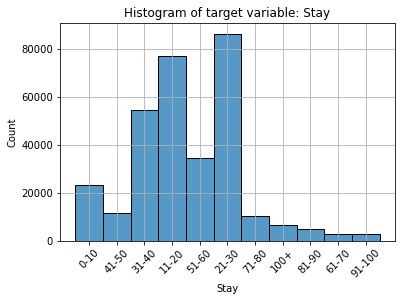

In [230]:
# View the distribution of target variable: Stay
sns.histplot(data=hc_data['Stay']).set(title='Histogram of target variable: Stay')
plt.xticks(rotation=45)
plt.grid()
plt.show()

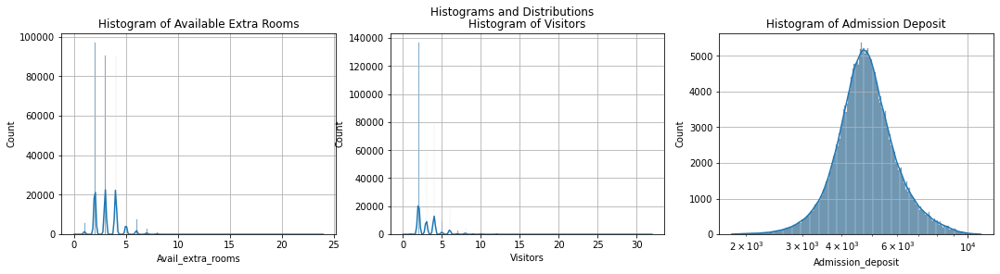

In [231]:
# View the distributions of the numerical variables
fig, axes = plt.subplots(ncols=3, figsize=(18, 4))

fig.suptitle("Histograms and Distributions")
sns.histplot(ax=axes[0], x=hc_data['Avail_extra_rooms'], kde=True)
axes[0].set_title('Histogram of Available Extra Rooms')
axes[0].grid()

sns.histplot(ax=axes[1], x=hc_data['Visitors'], kde=True)
axes[1].set_title('Histogram of Visitors')
axes[1].grid()

sns.histplot(ax=axes[2], x=hc_data['Admission_deposit'], log_scale=True, kde=True)
axes[2].set_title('Histogram of Admission Deposit')
axes[2].grid()
fig.savefig('images/histograms_raw_data.png')

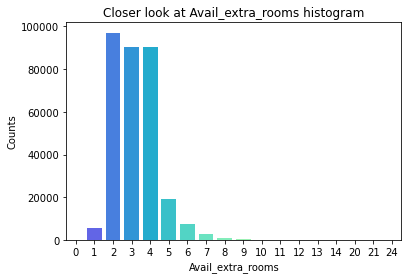

In [232]:
# See the distributions of Avail_extra_rooms and Visitors.
# The idea is to visualize and chop off the tails in the above histograms

c=sns.countplot(data=hc_data, x='Avail_extra_rooms', palette='rainbow')
c.set_xlabel('Avail_extra_rooms');
c.set_ylabel('Counts');
c.set_title('Closer look at Avail_extra_rooms histogram');

In [233]:
avail_rm_thresh = 10
avail_rm_thresh_pct = (hc_data.query('Avail_extra_rooms > @avail_rm_thresh')['Avail_extra_rooms'].value_counts().sum()*100)/len(hc_data)
print("Percentage of records with Avail_extra_rooms > {} is {:.2f}%".format(avail_rm_thresh, avail_rm_thresh_pct))

Percentage of records with Avail_extra_rooms > 10 is 0.01%


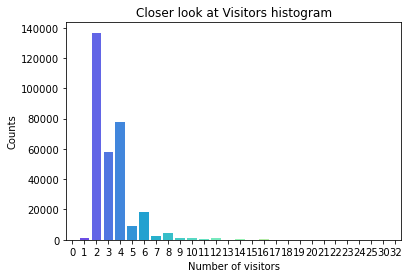

In [234]:
c=sns.countplot(data=hc_data, x='Visitors', palette='rainbow')
c.set_xlabel('Number of visitors');
c.set_ylabel('Counts');
c.set_title('Closer look at Visitors histogram');

In [235]:
visitor_thresh = 14
visitor_thresh_pct = (hc_data.query('Visitors > @visitor_thresh')['Visitors'].value_counts().sum()*100)/len(hc_data)
print("Percentage of records with Visitors > {} is {:.2f}%".format(visitor_thresh, visitor_thresh_pct))

Percentage of records with Visitors > 14 is 0.24%


#### Look at the violin plots of these columns to reinforce the above understanding

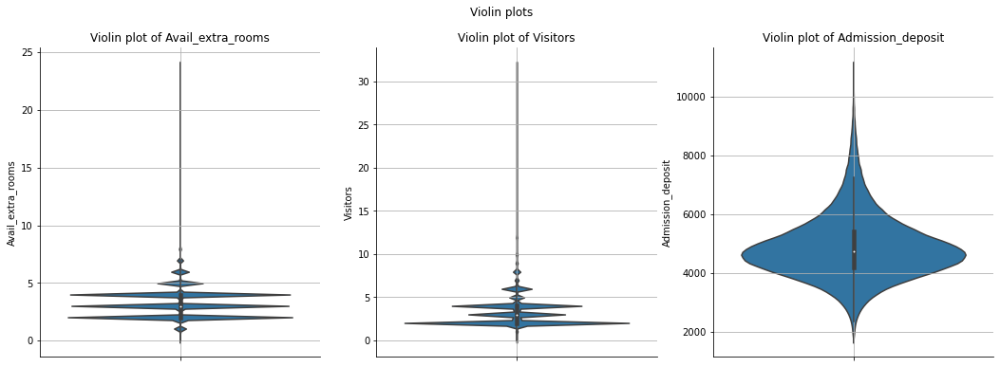

In [236]:
fig, axes = plt.subplots(ncols=3, figsize=(18, 6))
sns.despine(fig)
fig.suptitle("Violin plots");

sns.violinplot(ax=axes[0], data=hc_data, y='Avail_extra_rooms')
axes[0].set_title('Violin plot of Avail_extra_rooms');
axes[0].grid()

sns.violinplot(ax=axes[1], data=hc_data, y='Visitors')
axes[1].set_title('Violin plot of Visitors');
axes[1].grid()

sns.violinplot(ax=axes[2], data=hc_data, y='Admission_deposit')
axes[2].set_title('Violin plot of Admission_deposit');
axes[2].grid()

##### Tip for Data-cleaning: Drop the records with Avail_extra_rooms > 9 and Visitors > 10. This will give a more normal distribution-like shape to those variables. These records are more of like outliers.

#### Some more plots to understand data better. See 'Summary of Data understanding' cell below for conclusions from above plots

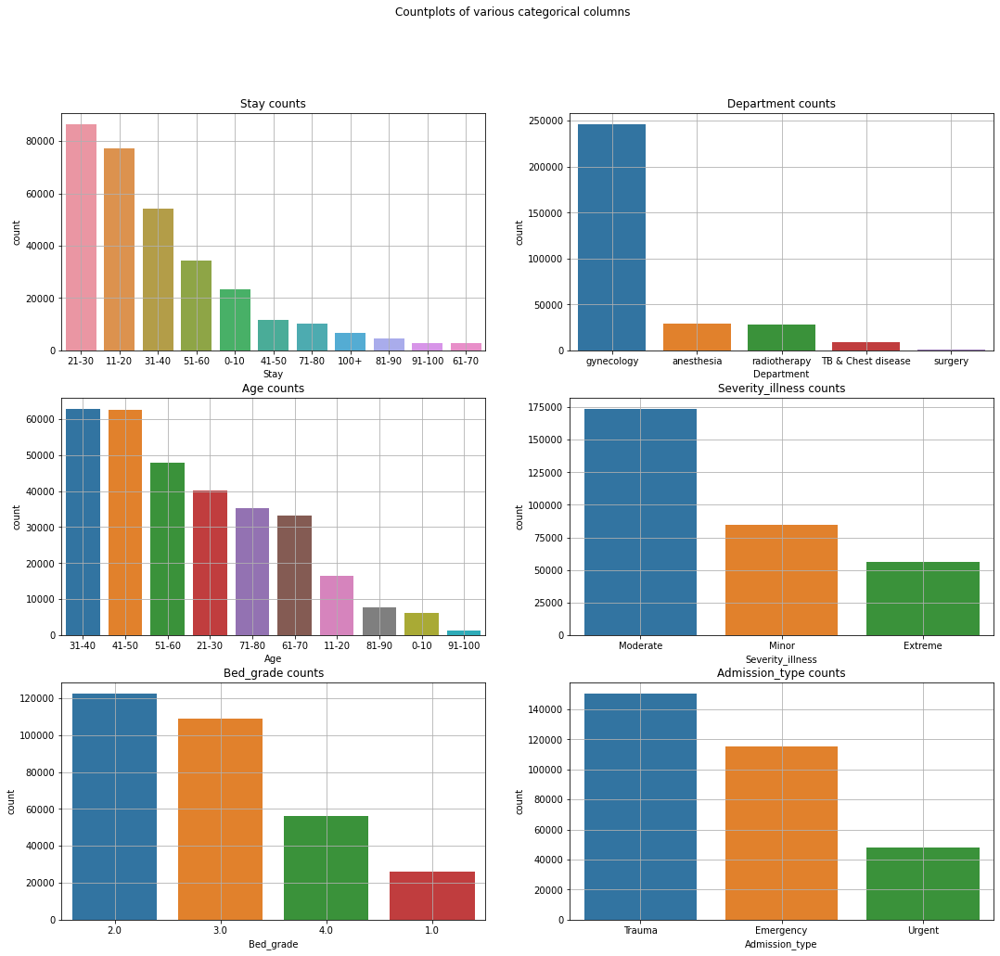

In [237]:
fig, axes = plt.subplots(nrows=3, ncols=2, figsize=(18, 16))

fig.suptitle("Countplots of various categorical columns")


sns.countplot(ax=axes[0][0], data=hc_data, x='Stay',
              order = hc_data['Stay'].value_counts().index);
axes[0][0].set_title('Stay counts')
axes[0][0].grid()

sns.countplot(ax=axes[0][1], data=hc_data, x='Department',
              order = hc_data['Department'].value_counts().index);
axes[0][1].set_title('Department counts')
axes[0][1].grid()

sns.countplot(ax=axes[1][0], data=hc_data, x='Age',
              order = hc_data['Age'].value_counts().index);
axes[1][0].set_title('Age counts')
axes[1][0].grid()

sns.countplot(ax=axes[1][1], data=hc_data, x='Severity_illness',
              order = hc_data['Severity_illness'].value_counts().index);
axes[1][1].set_title('Severity_illness counts')
axes[1][1].grid()

sns.countplot(ax=axes[2][0], data=hc_data, x='Bed_grade',
              order = hc_data['Bed_grade'].value_counts().index);
axes[2][0].set_title('Bed_grade counts')
axes[2][0].grid()

sns.countplot(ax=axes[2][1], data=hc_data, x='Admission_type',
              order = hc_data['Admission_type'].value_counts().index);
axes[2][1].set_title('Admission_type counts')
axes[2][1].grid()


In [238]:
fig1 = px.histogram(data_frame=hc_data, x='Stay', color='Severity_illness', 
             category_orders={'Stay': ["0-10", "11-20", "21-30", "31-40", "41-50", "51-60",
                                      "61-70", "71-80", "81-90", "91-100", "100+"]},
            color_discrete_sequence=px.colors.qualitative.Pastel, width=900, height=400)

fig1.update_layout(
            title=dict(text="Counts of 'Severity_illness' against the target variable 'Stay'",
            font=dict(size=14)), )
fig1.show()

fig2 = px.histogram(data_frame=hc_data, x='Stay', color='Admission_type', 
             category_orders={'Stay': ["0-10", "11-20", "21-30", "31-40", "41-50", "51-60",
                                      "61-70", "71-80", "81-90", "91-100", "100+"]},
            color_discrete_sequence=px.colors.qualitative.Pastel, width=900, height=400)

fig2.update_layout(
            title=dict(text="Counts of 'Admission_type' against the target variable 'Stay'",
            font=dict(size=14)))
fig2.show()

fig3 = px.histogram(data_frame=hc_data, x='Stay', color='Bed_grade', 
             category_orders={'Stay': ["0-10", "11-20", "21-30", "31-40", "41-50", "51-60",
                                      "61-70", "71-80", "81-90", "91-100", "100+"],
                              'Bed_grade': ["1.0", "2.0", "3.0", "4.0"]},
            color_discrete_sequence=px.colors.qualitative.Pastel, width=900, height=400)

fig3.update_layout(
            title=dict(text="Counts of 'Bed_grade' against the target variable 'Stay'",
            font=dict(size=14)))
fig3.show()

fig4 = px.histogram(data_frame=hc_data, x='Stay', color='Department', 
             category_orders={'Stay': ["0-10", "11-20", "21-30", "31-40", "41-50", "51-60",
                                      "61-70", "71-80", "81-90", "91-100", "100+"]},
            color_discrete_sequence=px.colors.qualitative.Pastel, width=900, height=400)

fig4.update_layout(
            title=dict(text="Counts of 'Department' against the target variable 'Stay'",
            font=dict(size=14)))
fig4.show()

fig5 = px.histogram(data_frame=hc_data, x='Stay', color='Ward_type', 
             category_orders={'Stay': ["0-10", "11-20", "21-30", "31-40", "41-50", "51-60",
                                      "61-70", "71-80", "81-90", "91-100", "100+"]},
            color_discrete_sequence=px.colors.qualitative.Pastel, width=900, height=400)

fig5.update_layout(
            title=dict(text="Counts of 'Ward_type' against the target variable 'Stay'",
            font=dict(size=14)))
fig5.show()

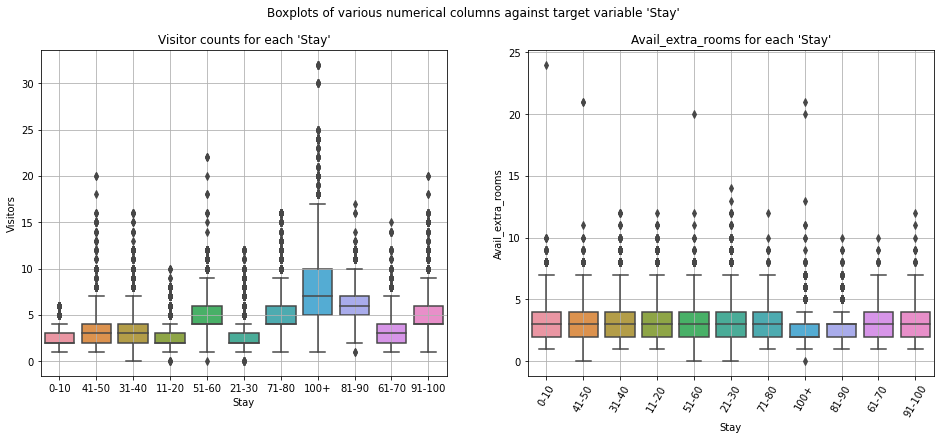

In [239]:
fig, axes = plt.subplots(ncols=2, figsize=(16, 6))

fig.suptitle("Boxplots of various numerical columns against target variable 'Stay'")

sns.boxplot(ax=axes[0], data=hc_data, x='Stay', y='Visitors')
plt.xticks(rotation=60);
axes[0].set_title("Visitor counts for each 'Stay'")
axes[0].grid()

sns.boxplot(ax=axes[1], data=hc_data, x='Stay', y='Avail_extra_rooms')
plt.xticks(rotation=60);
axes[1].set_title("Avail_extra_rooms for each 'Stay'")
axes[1].grid()


#### The means of 'Visitors' for most 'Stay' classes seem to be inline with the overall mean of 'Visitors' column (which is 3.28)
#### Similarly, the means of 'Avail_extra_rooms' for most 'Stay' classes seem to be inline with the overall mean of 'Avail_extra_rooms' column (which is 3.28)

#### No further data-cleaning needed w.r.t. these columns

## Summary of Data understanding

1. The Admission_deposit has a very nice normal distribution curve. No fine tuning needed for this column


2. A given patientid has multiple entries. This could be because the patient got admitted more than once. However, the case_ids of a patient are consecutive; this looks a bit weird and hinting that only for one admission, multiple entries got added (due to clerical error or different departments, etc). I have a suspicion this might skew results. But let's see after building some models.


3. Very high percentage of patients were admitted into Gynaecology department. 


4. Another observation is that "anesthesia" is a department by itself. A patient wouldn't get admitted just for getting anesthesia. I strongly believe these patients were actually admitted in regular departments who happened to need anesthesia for the treatment. Need to see if this 'superficial' department will impact the predictions. Let's keep this in mind for any fine-tuning the results


5. Bulk of the Stays are between 11 days to 40days. 
     a. Of these Stays, there are more 'Moderate' Severity-of-illness cases than 'Extreme' Severity
     b. Of these Stays, the patients with Bed_grades 3 and 4 are more than Bed_grades 1 and 2
     c. Of these Stays, most patients are from Gynaecology Department. This is not new information as the total patients admitted are in that department anyway



### More Tips for Data Preparation

4. Drop the records with Avail_extra_rooms > 9 and Visitors > 10. This will give a more normal distribution like shape to those variables. These records are more of like outliers.


# Step-3: Data Preparation

In [240]:

# Implement Tip 3 from previous stage
hc_data_clean = hc_data.drop(columns=['Case_id', 'Patient_id'], axis=1)

# Implement Tip-4 from previous stage
avail_rm_thresh = 9
visitor_thresh = 10
hc_data_clean2 = hc_data_clean.query('Avail_extra_rooms <= @avail_rm_thresh and Visitors <= @visitor_thresh')

print("Deleted {:.2f}% records".format((len(hc_data_clean) - len(hc_data_clean2))*100/len(hc_data_clean)))


Deleted 0.78% records


#### Ensure that the tails are chopped by looking at the Violin plots again (on hc_data_clean2)

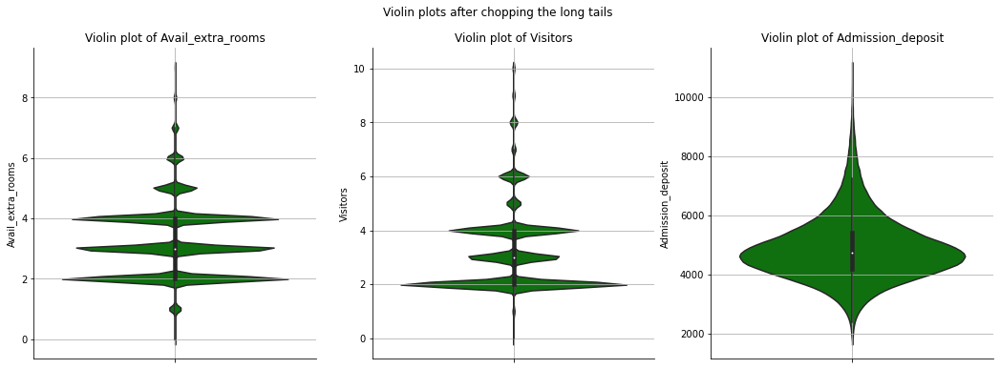

In [241]:
fig, axes = plt.subplots(ncols=3, figsize=(18, 6))
sns.despine(fig)
fig.suptitle("Violin plots after chopping the long tails");

sns.violinplot(ax=axes[0], data=hc_data_clean2, y='Avail_extra_rooms', color='g')
axes[0].set_title('Violin plot of Avail_extra_rooms');
axes[0].grid()

sns.violinplot(ax=axes[1], data=hc_data_clean2, y='Visitors', color='g')
axes[1].set_title('Violin plot of Visitors');
axes[1].grid()

sns.violinplot(ax=axes[2], data=hc_data_clean2, y='Admission_deposit', color='g')
axes[2].set_title('Violin plot of Admission_deposit');
axes[2].grid()

In [242]:
hc_data_clean2.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 311360 entries, 0 to 318437
Data columns (total 16 columns):
 #   Column                Non-Null Count   Dtype  
---  ------                --------------   -----  
 0   Hospital_code         311360 non-null  int64  
 1   Hospital_type_code    311360 non-null  object 
 2   City_code_hospital    311360 non-null  int64  
 3   Hospital_region_code  311360 non-null  object 
 4   Avail_extra_rooms     311360 non-null  int64  
 5   Department            311360 non-null  object 
 6   Ward_type             311360 non-null  object 
 7   Ward_facility_code    311360 non-null  object 
 8   Bed_grade             311360 non-null  float64
 9   City_code_patient     311360 non-null  float64
 10  Admission_type        311360 non-null  object 
 11  Severity_illness      311360 non-null  object 
 12  Visitors              311360 non-null  int64  
 13  Age                   311360 non-null  object 
 14  Admission_deposit     311360 non-null  float64
 15  

### More Data Preparation Tips

1. Use OrdinalEncoder for columns: Severity_illness, Age.  The categories in these columns have an order


2. Use OneHotEncoder for columns: Hospital_code, Hospital_type_code, City_code_hospital, Hospital_region_code, Department, Ward_type, Ward_facility_code, Bed_grade, City_code_patient, Admission_type


#### These will be implemented in Pipelines during model building

In [243]:
target_map = {'0-10':0, '11-20':1, '21-30':2, '31-40':3, '41-50':4, '51-60':5, '61-70':6, 
              '71-80':7, '81-90':8, '91-100':9, '100+':10}

In [244]:
target_rev_map = {0:'0-10', 1:'11-20', 2:'21-30', 3:'31-40', 4:'41-50', 5:'51-60', 6:'61-70', 
                  7:'71-80', 8:'81-90', 9:'91-100', 10:'100+'}

#### Split the data into training, validation and test datasets

In [245]:
# Define the predictor variables (X) and target variable y
# Perform a train/development/test split of 70/20/10
# Using stratification, so that the target variable classes are distributed equally in train/dev/test sets

X = hc_data_clean2.drop(columns=['Stay'])
y = hc_data_clean2['Stay'].map(target_map)

print("Dataset size:\t{}, {}".format(X.shape, y.shape))
train_size = int(X.shape[0] * 0.70)
dev_size   = int(X.shape[0] * 0.20)
test_size  = int(X.shape[0] * 0.10)

# First get the test split
X_train_tmp, X_test, y_train_tmp, y_test = train_test_split(X, y, test_size=test_size, random_state=1234, stratify=y)
# Then get the train and dev splits
X_train, X_dev, y_train, y_dev = train_test_split(X_train_tmp, y_train_tmp, train_size=train_size, random_state=1234,
                                                  stratify=y_train_tmp)

print("Trainset size:\t{}, {}".format(X_train.shape, y_train.shape))
print("Devset size:\t{}, {}".format(X_dev.shape, y_dev.shape))
print("Testset size:\t{}, {}".format(X_test.shape, y_test.shape))

Dataset size:	(311360, 15), (311360,)
Trainset size:	(217952, 15), (217952,)
Devset size:	(62272, 15), (62272,)
Testset size:	(31136, 15), (31136,)


In [246]:
# Utility functions
def print_train_test_evaluation(estimator, X_trainset, y_trainset, X_devset, y_devset, X_testset, y_testset, descr):
    curmodel_acc_train = round(accuracy_score(y_trainset, estimator.predict(X_trainset))*100, 2)
    curmodel_acc_dev   = round(accuracy_score(y_devset, estimator.predict(X_devset))*100, 2)
    curmodel_acc_test  = round(accuracy_score(y_testset, estimator.predict(X_testset))*100, 2)
    curmodel_f1_test   = round(f1_score(y_testset, estimator.predict(X_testset), average='micro')*100, 2)

    print(f'{descr} accuracy on train-data:\t{curmodel_acc_train}')
    print(f'{descr} accuracy on dev-data: \t{curmodel_acc_dev}')
    print(f'{descr} accuracy on test-data:\t{curmodel_acc_test}')
    print(f'{descr} F1 score on test-data:\t{curmodel_f1_test}')
    
    y_curpreds = estimator.predict(X_testset)
    print(classification_report(y_testset, y_curpreds))
    
    return curmodel_acc_train,curmodel_acc_dev,curmodel_acc_test,curmodel_f1_test

In [247]:
# Utility function to display ROC curves for various classes in target variable using one-vs-rest
def display_roc_curves(estimator, X_test, y_test, descr):
    fig, axes = plt.subplots(nrows=4, ncols=3, figsize=(15,20))
    fig.suptitle(f"{descr}: ROC curves of various target classes")

    y_score = estimator.predict_proba(X_test)
    y_onehot_test = LabelBinarizer().fit_transform(y_test)

    i = 0
    j = 0
    for staykey in target_rev_map.keys():
        RocCurveDisplay.from_predictions(
                            y_onehot_test[:, staykey],
                            y_score[:, staykey],
                            name=f"{target_rev_map[staykey]} days vs Rest",
                            color="darkorange",
                            ax=axes[i][j]
                            )

        axes[i][j].plot([0, 1], [0, 1], "k--", label="chance level (AUC = 0.5)", )
        axes[i][j].axis("square")
        axes[i][j].set_xlabel("False Positive Rate")
        axes[i][j].set_ylabel("True Positive Rate")
        axes[i][j].set_title(f"{target_rev_map[staykey]} days vs Rest ROC")
        axes[i][j].legend()
        j += 1
        if j == 3:
            j = 0
            i += 1

### Selecting the Models evaluation metric

This is a classification problem where there are multiple classes in the target variable 'Stay'. These classes have very uneven distribution as seen during the EDA.

Given the above facts, it is ideal to evaluate the models' performance using the F1 score as the primary metric. We will also use Accuracy scores in tandem.

# Step-4: Modeling

I will build models using:
+ Logistic Regression
+ kNN
+ Decision Trees
+ Random Forests
+ Boosting techniques


In [248]:
# I'll maintain results of the models in the below list of lists
# Each entry will be a list with format: 
#   ['Model-name', 'Model-description', 'Purpose', '# Dimensions', 'Train/Dev/Test Accuracy scores', 'F1 Score']
results = []

##### Model 0: This is just for a base-line and not a real ML model. If someone was guessing the target variable at random, what would be the accuracy?

There are 11 classes in the target variable 'Stay'. So, a random guessing will result in 100/11 = 9.09% accuracy

In [249]:
results.append(['Model0', 'Random guessing', 'For a baseline', '---', '9.09', '---'])

#### Build Logistic Regression based model(s)

##### Model 1: Logistic regression model with default options.

In [250]:
onehot_cols = ['Hospital_code', 'Hospital_type_code', 'City_code_hospital', 'Hospital_region_code', 'Department',
              'Ward_type', 'Ward_facility_code', 'Bed_grade', 'City_code_patient', 'Admission_type']

ordinal_cols = ['Severity_illness', 'Age']

In [251]:
ordinal_ohe_transformer = make_column_transformer(
                            (OneHotEncoder(drop = 'if_binary'), onehot_cols),
                            (OrdinalEncoder(categories = [['0-10', '11-20', '21-30', '31-40', '41-50', '51-60',
                                                           '61-70', '71-80', '81-90', '91-100']]), ['Age']),
                            (OrdinalEncoder(categories = [['Minor', 'Moderate', 'Extreme']]), ['Severity_illness']),
                            remainder=StandardScaler())

In [252]:
model1 = Pipeline([('transformer', ordinal_ohe_transformer),
                     ('lgr', LogisticRegression(multi_class='ovr', random_state=1234, max_iter=1000))])
model1.fit(X_train, y_train)

display(model1)

Pipeline(steps=[('transformer',
                 ColumnTransformer(remainder=StandardScaler(),
                                   transformers=[('onehotencoder',
                                                  OneHotEncoder(drop='if_binary'),
                                                  ['Hospital_code',
                                                   'Hospital_type_code',
                                                   'City_code_hospital',
                                                   'Hospital_region_code',
                                                   'Department', 'Ward_type',
                                                   'Ward_facility_code',
                                                   'Bed_grade',
                                                   'City_code_patient',
                                                   'Admission_type']),
                                                 ('ordinalencoder-1',
                                                  OrdinalEncoder(categories=[['0-10',
                                                                              '11-20',
                                                                              '21-30',
                                                                              '31-40',
                                                                              '41-50',
                                                                              '51-60',
                                                                              '61-70',
                                                                              '71-80',
                                                                              '81-90',
                                                                              '91-100']]),
                                                  ['Age']),
                                                 ('ordinalencoder-2',
                                                  OrdinalEncoder(categories=[['Minor',
                                                                              'Moderate',
                                                                              'Extreme']]),
                                                  ['Severity_illness'])])),
                ('lgr',
                 LogisticRegression(max_iter=1000, multi_class='ovr',
                                    random_state=1234))])

In [253]:
model1_acc_train,model1_acc_dev,model1_acc_test,model1_f1_test = \
        print_train_test_evaluation(model1, X_train, y_train, X_dev, y_dev, X_test, y_test, "Model1 Logistic Regression")

Model1 Logistic Regression accuracy on train-data:	38.91
Model1 Logistic Regression accuracy on dev-data: 	38.85
Model1 Logistic Regression accuracy on test-data:	38.65
Model1 Logistic Regression F1 score on test-data:	38.65
              precision    recall  f1-score   support

           0       0.42      0.04      0.07      2324
           1       0.38      0.51      0.44      7707
           2       0.40      0.67      0.50      8626
           3       0.32      0.14      0.19      5422
           4       0.00      0.00      0.00      1149
           5       0.37      0.44      0.40      3429
           6       0.00      0.00      0.00       267
           7       0.00      0.00      0.00       977
           8       0.00      0.00      0.00       461
           9       0.00      0.00      0.00       253
          10       0.75      0.02      0.03       521

    accuracy                           0.39     31136
   macro avg       0.24      0.16      0.15     31136
weighted avg     

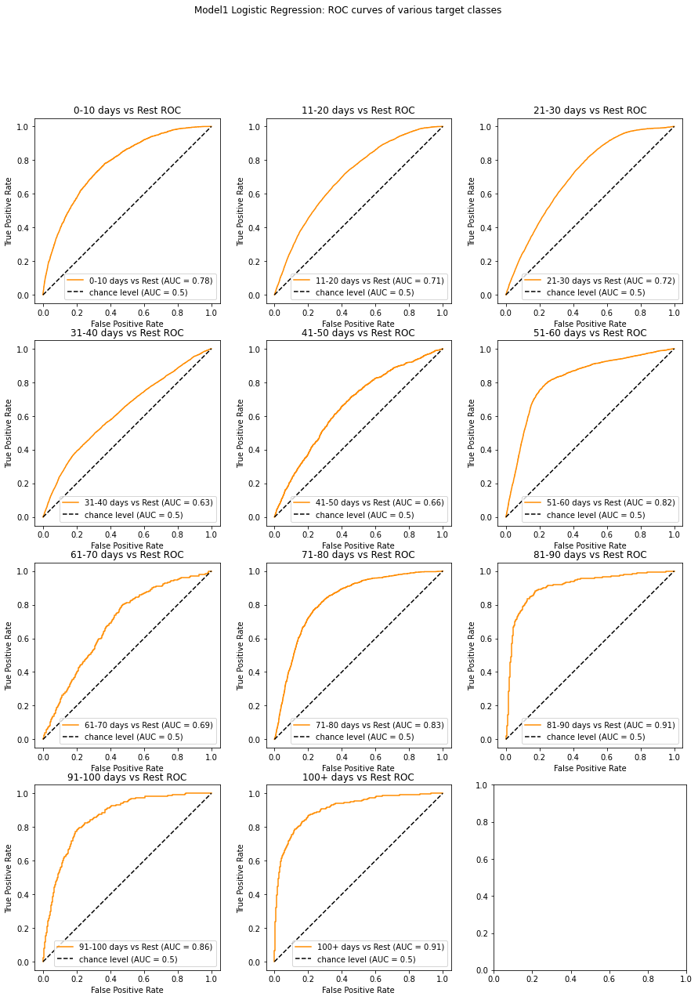

In [254]:
display_roc_curves(model1, X_test, y_test, "Model1 Logistic Regression")

#### Model1 performance is around 38%; Much better than a random guessing scheme, but not good enough for being a good predictor. Even the accuracy on train dataset is just about the same.

#### Let's look at the confusion matrix to see it gives any clues

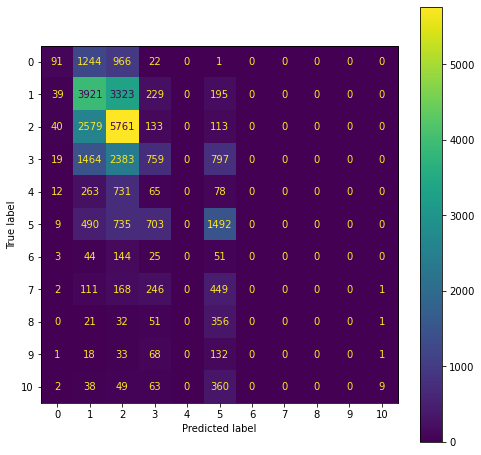

In [255]:
fig, axes = plt.subplots( figsize=(8, 8))
ConfusionMatrixDisplay.from_predictions(y_test, model1.predict(X_test), ax=axes);

##### <ins>Conclusion on Model 1:</ins>
1. The train/dev/test accuracies are on the lower side with Model 1. 


2. The fact that the train accuracy is also low, indicates the model is under-fitting.


3. A large chunk of Label 1 is predicted as Label 2. Similarly, a large chunk of Label 2 is predicted as Label 1. If the model can be improved to differentiate these labels, the accuracies will improve dramatically. On those lines, these are the low-hanging fruits. 


4. It is hard to find the dimensionality if OrdinalEncoder is present in make_column_transformer. In the next, model, I will encode all the categorical variables as one-hot. If the performance improves or atleast at par with model-1, I'll ignore OrdinalEncoder going forward


5. The AUC in the ROC curve of target class 3 ('31-40' days) is the lowest of the AUCs of all other classes. This is also reflected from the confusion matrix

In [256]:
results.append(['Model1', 'Logistic Regr', 'Initial logistic regr model', '---',
                '{}/{}/{}'.format(model1_acc_train, model1_acc_dev, model1_acc_test),
                model1_f1_test])

##### Let's take a closer exploratory data analysis for target Label 1 and 2 (i.e., Stay of 11-20 and 21-30 days), since there seems to be a big overlap in the confusion matrix for these two target labels

In [257]:
hc_data_label1and2 = hc_data.query('Stay in "11-20" or Stay in "21-30"')

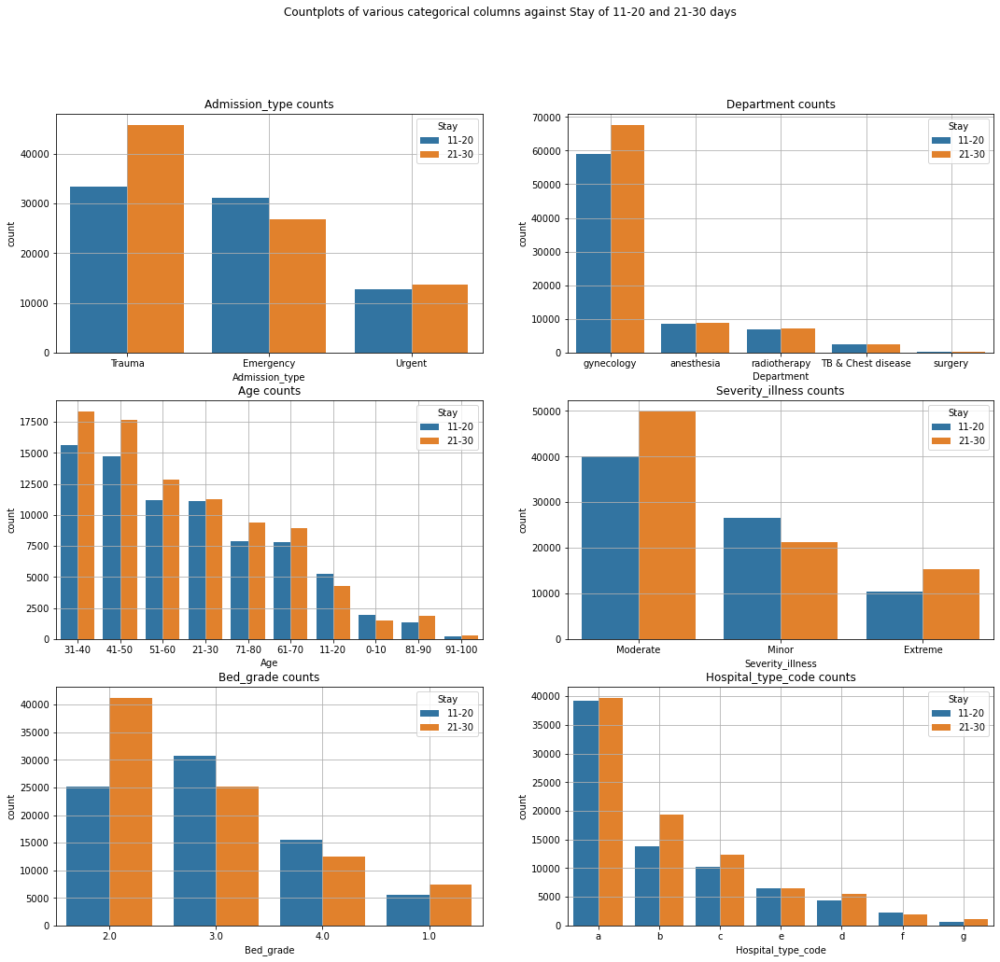

In [258]:
fig2, axes = plt.subplots(nrows=3, ncols=2, figsize=(18, 16))
fig2.suptitle("Countplots of various categorical columns against Stay of 11-20 and 21-30 days")

sns.countplot(ax=axes[0][0], data=hc_data_label1and2, x='Admission_type',
              order = hc_data_label1and2['Admission_type'].value_counts().index, hue='Stay');
axes[0][0].set_title('Admission_type counts')
axes[0][0].grid()

sns.countplot(ax=axes[0][1], data=hc_data_label1and2, x='Department',
              order = hc_data_label1and2['Department'].value_counts().index, hue='Stay');
axes[0][1].set_title('Department counts')
axes[0][1].grid()

sns.countplot(ax=axes[1][0], data=hc_data_label1and2, x='Age',
              order = hc_data_label1and2['Age'].value_counts().index, hue='Stay');
axes[1][0].set_title('Age counts')
axes[1][0].grid()

sns.countplot(ax=axes[1][1], data=hc_data_label1and2, x='Severity_illness',
              order = hc_data_label1and2['Severity_illness'].value_counts().index, hue='Stay');
axes[1][1].set_title('Severity_illness counts')
axes[1][1].grid()

sns.countplot(ax=axes[2][0], data=hc_data_label1and2, x='Bed_grade',
              order = hc_data_label1and2['Bed_grade'].value_counts().index, hue='Stay');
axes[2][0].set_title('Bed_grade counts')
axes[2][0].grid()

sns.countplot(ax=axes[2][1], data=hc_data_label1and2, x='Hospital_type_code',
              order = hc_data_label1and2['Hospital_type_code'].value_counts().index, hue='Stay');
axes[2][1].set_title('Hospital_type_code counts')
axes[2][1].grid()

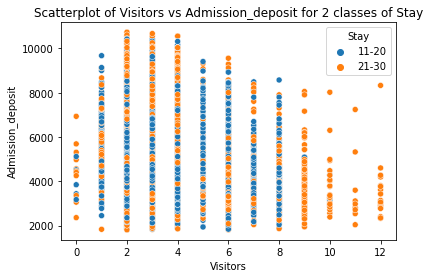

In [259]:
sns.scatterplot(data=hc_data_label1and2, x='Visitors', y='Admission_deposit', hue='Stay').set(title='Scatterplot of Visitors vs Admission_deposit for 2 classes of Stay');


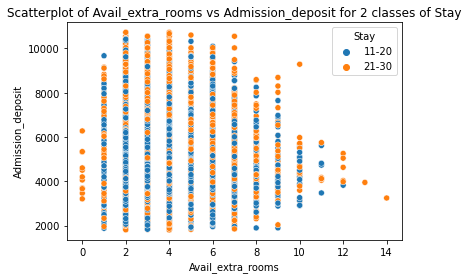

In [260]:
sns.scatterplot(data=hc_data_label1and2, x='Avail_extra_rooms', y='Admission_deposit', hue='Stay').set(title='Scatterplot of Avail_extra_rooms vs Admission_deposit for 2 classes of Stay');

#### Conclusion on Closer look at Stays 11-20 and 21-30

Looking at the scatterplots, when the number of Visitors is <= 8, it seems like there's lot of overlap between these two target classes. Similarly, until Avail_extra_rooms is <= 12, there's seems to be a lot of overlap between these two target classes

##### Model 2: Model 1 + Onehot encoding for all categorical variables. This is to see if it makes any performance difference by eliminating Ordinal encoding

In [261]:
cat_cols = ['Hospital_code', 'Hospital_type_code', 'City_code_hospital', 'Hospital_region_code', 'Department',
              'Ward_type', 'Ward_facility_code', 'Bed_grade', 'City_code_patient', 'Admission_type',
               'Severity_illness', 'Age']


In [262]:
ohe_transformer = make_column_transformer(
                            (OneHotEncoder(drop = 'if_binary'), cat_cols),
                            remainder=StandardScaler())

In [263]:
model2 = Pipeline([('transformer', ohe_transformer),
                     ('lgr', LogisticRegression(multi_class='ovr', random_state=1234, max_iter=1000))])
model2.fit(X_train, y_train)

display(model2)

Pipeline(steps=[('transformer',
                 ColumnTransformer(remainder=StandardScaler(),
                                   transformers=[('onehotencoder',
                                                  OneHotEncoder(drop='if_binary'),
                                                  ['Hospital_code',
                                                   'Hospital_type_code',
                                                   'City_code_hospital',
                                                   'Hospital_region_code',
                                                   'Department', 'Ward_type',
                                                   'Ward_facility_code',
                                                   'Bed_grade',
                                                   'City_code_patient',
                                                   'Admission_type',
                                                   'Severity_illness',
                                                   'Age'])])),
                ('lgr',
                 LogisticRegression(max_iter=1000, multi_class='ovr',
                                    random_state=1234))])

In [264]:
model2_acc_train,model2_acc_dev,model2_acc_test,model2_f1_test = \
        print_train_test_evaluation(model2, X_train, y_train, X_dev, y_dev, X_test, y_test, "Model2 Logistic Regression")

Model2 Logistic Regression accuracy on train-data:	38.97
Model2 Logistic Regression accuracy on dev-data: 	38.89
Model2 Logistic Regression accuracy on test-data:	38.87
Model2 Logistic Regression F1 score on test-data:	38.87
              precision    recall  f1-score   support

           0       0.42      0.04      0.07      2324
           1       0.39      0.51      0.44      7707
           2       0.40      0.67      0.51      8626
           3       0.32      0.14      0.20      5422
           4       0.00      0.00      0.00      1149
           5       0.37      0.44      0.40      3429
           6       0.00      0.00      0.00       267
           7       0.00      0.00      0.00       977
           8       0.00      0.00      0.00       461
           9       0.00      0.00      0.00       253
          10       0.67      0.02      0.04       521

    accuracy                           0.39     31136
   macro avg       0.23      0.17      0.15     31136
weighted avg     

In [265]:
model2_dims = len(model2.named_steps['transformer'].get_feature_names_out().tolist())
print(f'Logistic Regression Model2 Number of dimensions:\t{model2_dims}')

Logistic Regression Model2 Number of dimensions:	130


In [266]:
results.append(['Model2', 'Logistic Regr with OneHot on all categ', 'Consolidated onehot encoding', '{}'.format(model2_dims),
                '{}/{}/{}'.format(model2_acc_train, model2_acc_dev, model2_acc_test),
                model2_f1_test])

##### <ins>Conclusion on Model 2:</ins>
1. Pretty much same as Model 1 


2. As the OrdinalEncoding is not making much difference, I'll continue to use OneHot encoding on all categorical variables from now on, to simplify

##### Model 3: Try different hyper-parameters of Logistic Regression using GridSearchCV

In [267]:
model3_param_dict = {'lgr__C': np.logspace(-5, .5, 10),
                     'lgr__multi_class': ['ovr', 'multinomial'],
                     'lgr__max_iter': [1000, 1500]
                    }

In [268]:
model3 = Pipeline([('transformer', ohe_transformer),
                     ('lgr', LogisticRegression(random_state=1234))])

In [269]:
model3_grid = GridSearchCV(model3, model3_param_dict, scoring='accuracy', cv=2, 
                         verbose=0, return_train_score=True, n_jobs=-1)

In [270]:
%%time
model3_grid.fit(X_train, y_train)

CPU times: user 59.5 s, sys: 1.42 s, total: 1min
Wall time: 3min 36s


GridSearchCV(cv=2,
             estimator=Pipeline(steps=[('transformer',
                                        ColumnTransformer(remainder=StandardScaler(),
                                                          transformers=[('onehotencoder',
                                                                         OneHotEncoder(drop='if_binary'),
                                                                         ['Hospital_code',
                                                                          'Hospital_type_code',
                                                                          'City_code_hospital',
                                                                          'Hospital_region_code',
                                                                          'Department',
                                                                          'Ward_type',
                                                                          'Ward_facility_code',
                                                                          'Bed_grade',
                                                                          'City_code_patient',
                                                                          'Admission_type',
                                                                          'Sever...
                                       ('lgr',
                                        LogisticRegression(random_state=1234))]),
             n_jobs=-1,
             param_grid={'lgr__C': array([1.00000000e-05, 4.08423865e-05, 1.66810054e-04, 6.81292069e-04,
       2.78255940e-03, 1.13646367e-02, 4.64158883e-02, 1.89573565e-01,
       7.74263683e-01, 3.16227766e+00]),
                         'lgr__max_iter': [1000, 1500],
                         'lgr__multi_class': ['ovr', 'multinomial']},
             return_train_score=True, scoring='accuracy')

In [271]:
display(model3_grid.best_estimator_.get_params())

{'memory': None,
 'steps': [('transformer',
   ColumnTransformer(remainder=StandardScaler(),
                     transformers=[('onehotencoder',
                                    OneHotEncoder(drop='if_binary'),
                                    ['Hospital_code', 'Hospital_type_code',
                                     'City_code_hospital', 'Hospital_region_code',
                                     'Department', 'Ward_type',
                                     'Ward_facility_code', 'Bed_grade',
                                     'City_code_patient', 'Admission_type',
                                     'Severity_illness', 'Age'])])),
  ('lgr',
   LogisticRegression(C=0.18957356524063793, max_iter=1000,
                      multi_class='multinomial', random_state=1234))],
 'verbose': False,
 'transformer': ColumnTransformer(remainder=StandardScaler(),
                   transformers=[('onehotencoder',
                                  OneHotEncoder(drop='if_binary'),
     

In [272]:
print(model3_grid.best_params_)

{'lgr__C': 0.18957356524063793, 'lgr__max_iter': 1000, 'lgr__multi_class': 'multinomial'}


In [273]:
model3_acc_train,model3_acc_dev,model3_acc_test,model3_f1_test = \
        print_train_test_evaluation(model3_grid.best_estimator_, X_train, y_train, X_dev, y_dev, X_test, y_test, "Model3 Gridsearch Logistic Regr")

Model3 Gridsearch Logistic Regr accuracy on train-data:	40.13
Model3 Gridsearch Logistic Regr accuracy on dev-data: 	40.14
Model3 Gridsearch Logistic Regr accuracy on test-data:	40.13
Model3 Gridsearch Logistic Regr F1 score on test-data:	40.13
              precision    recall  f1-score   support

           0       0.41      0.07      0.12      2324
           1       0.41      0.50      0.45      7707
           2       0.42      0.65      0.51      8626
           3       0.33      0.21      0.25      5422
           4       0.00      0.00      0.00      1149
           5       0.39      0.49      0.43      3429
           6       0.00      0.00      0.00       267
           7       0.00      0.00      0.00       977
           8       0.12      0.01      0.01       461
           9       0.00      0.00      0.00       253
          10       0.44      0.22      0.30       521

    accuracy                           0.40     31136
   macro avg       0.23      0.19      0.19     311

In [274]:
model3_dims = len(model3_grid.best_estimator_.named_steps['transformer'].get_feature_names_out().tolist())
print(f'Model3 Logistic Regression: Number of dimensions:\t{model3_dims}')

Model3 Logistic Regression: Number of dimensions:	130


In [275]:
results.append(['Model3', 'GridSearch Logistic Regr hyper params', '{}'.format(model3_grid.best_params_),
                '{}'.format(model3_dims),
                '{}/{}/{}'.format(model3_acc_train, model3_acc_dev, model3_acc_test),
                model3_f1_test])

##### <ins>Conclusion on Model 3:</ins>
1. The search found the hyper-parameters that improved the accuracy by ~2%. Not a huge increase but good enough to record this in results_df

### Model 4: KNearestNeighbors Classifier

In [276]:
k_range = list(range(10, 101, 15))
model4_param_dict = {'knn__n_neighbors': k_range}

In [277]:
model4 = Pipeline([('transformer', ohe_transformer),
                     ('knn', KNeighborsClassifier())])

In [278]:
%%time
model4_knn_grid = GridSearchCV(model4, model4_param_dict, scoring='accuracy', cv=2, verbose=0, n_jobs=-1)
model4_knn_grid.fit(X_train, y_train)

CPU times: user 1.69 s, sys: 8.1 s, total: 9.79 s
Wall time: 1h 21min 24s


GridSearchCV(cv=2,
             estimator=Pipeline(steps=[('transformer',
                                        ColumnTransformer(remainder=StandardScaler(),
                                                          transformers=[('onehotencoder',
                                                                         OneHotEncoder(drop='if_binary'),
                                                                         ['Hospital_code',
                                                                          'Hospital_type_code',
                                                                          'City_code_hospital',
                                                                          'Hospital_region_code',
                                                                          'Department',
                                                                          'Ward_type',
                                                                          'Ward_facility_code',
                                                                          'Bed_grade',
                                                                          'City_code_patient',
                                                                          'Admission_type',
                                                                          'Severity_illness',
                                                                          'Age'])])),
                                       ('knn', KNeighborsClassifier())]),
             n_jobs=-1,
             param_grid={'knn__n_neighbors': [10, 25, 40, 55, 70, 85, 100]},
             scoring='accuracy')

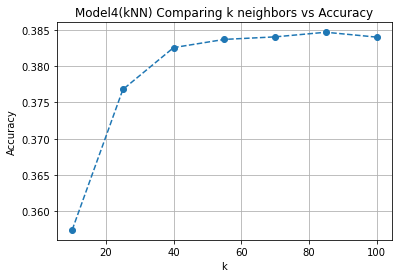

In [279]:
plt.plot(k_range, model4_knn_grid.cv_results_['mean_test_score'], '--o')
plt.title("Model4(kNN) Comparing k neighbors vs Accuracy")
plt.xlabel('k')
plt.ylabel('Accuracy')
plt.grid();

In [280]:
print(model4_knn_grid.best_params_)

{'knn__n_neighbors': 85}


In [281]:
model4_acc_train,model4_acc_dev,model4_acc_test,model4_f1_test = \
        print_train_test_evaluation(model4_knn_grid.best_estimator_, X_train, y_train, X_dev, y_dev, X_test, y_test, "Model4 Gridsearch kNN")

Model4 Gridsearch kNN accuracy on train-data:	40.83
Model4 Gridsearch kNN accuracy on dev-data: 	39.21
Model4 Gridsearch kNN accuracy on test-data:	39.25
Model4 Gridsearch kNN F1 score on test-data:	39.25
              precision    recall  f1-score   support

           0       0.46      0.04      0.08      2324
           1       0.40      0.47      0.43      7707
           2       0.39      0.70      0.50      8626
           3       0.39      0.18      0.25      5422
           4       0.00      0.00      0.00      1149
           5       0.38      0.40      0.39      3429
           6       0.00      0.00      0.00       267
           7       0.57      0.00      0.01       977
           8       0.14      0.00      0.00       461
           9       0.00      0.00      0.00       253
          10       0.50      0.18      0.27       521

    accuracy                           0.39     31136
   macro avg       0.29      0.18      0.18     31136
weighted avg       0.38      0.39    

In [282]:
model4_dims = len(model4_knn_grid.best_estimator_.named_steps['transformer'].get_feature_names_out().tolist())
print(f'Model4 kNN: Number of dimensions:\t{model4_dims}')

Model4 kNN: Number of dimensions:	130


In [283]:
results.append(['Model4', 'GridSearch kNN hyper params', '{}'.format(model4_knn_grid.best_params_),
                '{}'.format(model4_dims),
                '{}/{}/{}'.format(model4_acc_train, model4_acc_dev, model4_acc_test),
                model4_f1_test])

##### Model 5: Try Decision Tree Classifier. I'll start with a fairly moderate depth of 10 with all other default parameters.

In [284]:
model5 = Pipeline([('transformer', ohe_transformer),
                     ('dt', DecisionTreeClassifier(max_depth=10, random_state=1234))])
model5.fit(X_train, y_train)

Pipeline(steps=[('transformer',
                 ColumnTransformer(remainder=StandardScaler(),
                                   transformers=[('onehotencoder',
                                                  OneHotEncoder(drop='if_binary'),
                                                  ['Hospital_code',
                                                   'Hospital_type_code',
                                                   'City_code_hospital',
                                                   'Hospital_region_code',
                                                   'Department', 'Ward_type',
                                                   'Ward_facility_code',
                                                   'Bed_grade',
                                                   'City_code_patient',
                                                   'Admission_type',
                                                   'Severity_illness',
                                                   'Age'])])),
                ('dt',
                 DecisionTreeClassifier(max_depth=10, random_state=1234))])

In [285]:
model5_acc_train,model5_acc_dev,model5_acc_test,model5_f1_test = \
        print_train_test_evaluation(model5, X_train, y_train, X_dev, y_dev, X_test, y_test, "Model5 Decision tree")

Model5 Decision tree accuracy on train-data:	42.14
Model5 Decision tree accuracy on dev-data: 	41.22
Model5 Decision tree accuracy on test-data:	41.22
Model5 Decision tree F1 score on test-data:	41.22
              precision    recall  f1-score   support

           0       0.35      0.14      0.20      2324
           1       0.42      0.50      0.46      7707
           2       0.42      0.64      0.51      8626
           3       0.41      0.23      0.29      5422
           4       0.10      0.00      0.00      1149
           5       0.41      0.49      0.44      3429
           6       0.00      0.00      0.00       267
           7       0.26      0.01      0.02       977
           8       0.29      0.11      0.16       461
           9       0.80      0.02      0.03       253
          10       0.43      0.29      0.34       521

    accuracy                           0.41     31136
   macro avg       0.35      0.22      0.22     31136
weighted avg       0.39      0.41      0.

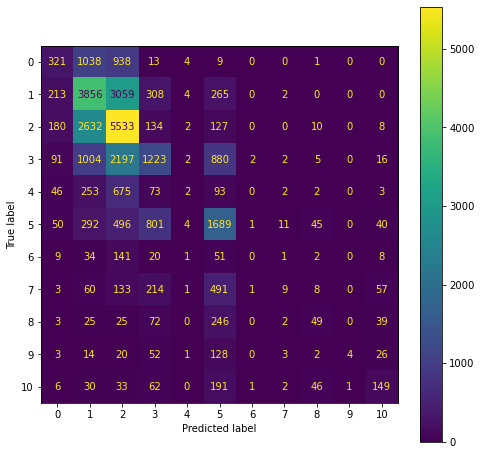

In [286]:
fig, axes = plt.subplots( figsize=(8, 8))
ConfusionMatrixDisplay.from_predictions(y_test, model5.predict(X_test), ax=axes)

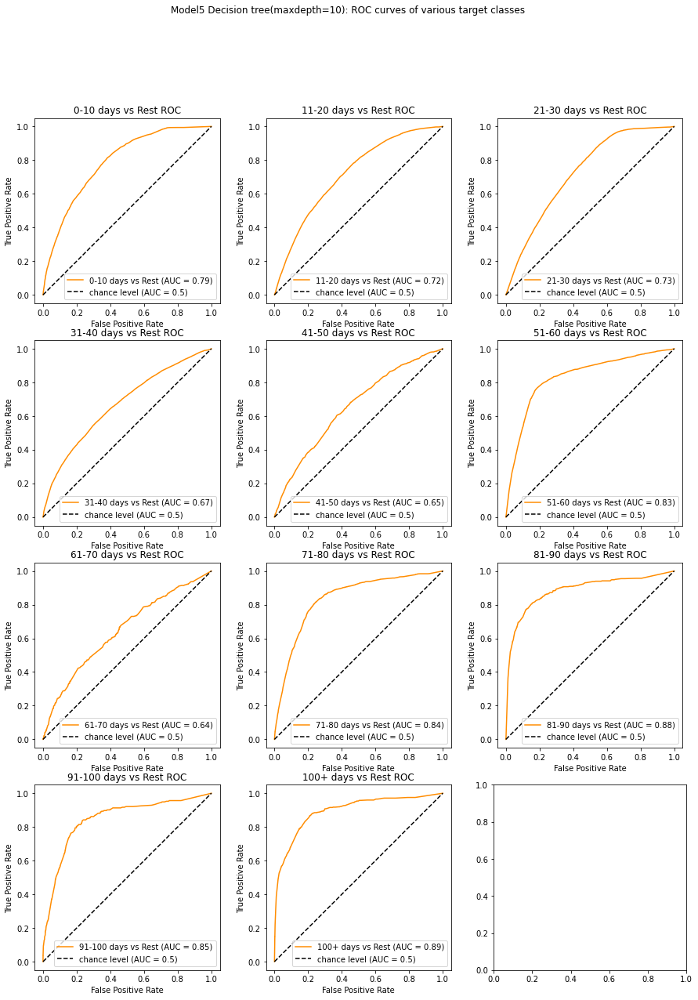

In [287]:
display_roc_curves(model5, X_test, y_test, "Model5 Decision tree(maxdepth=10)")

In [288]:
model5_dims = len(model5.named_steps['transformer'].get_feature_names_out().tolist())

In [289]:
results.append(['Model5', 'Decision Tree 1', 'Moderate depth of 10',
                '{}'.format(model5_dims),
                '{}/{}/{}'.format(model5_acc_train, model5_acc_dev, model5_acc_test),
                model5_f1_test])

##### <ins>Conclusion on Model 5:</ins>
There's a small improvement in accuracy in model 5 as compared to the previous models. The training and test scores are on the same lines, still hinting that the model is under-fitted.

In the next model, I'll go all in on the maxdepth hyper-parameter. It might over-fit, but let's see if the test scores behave better

##### Model 6: Try a deeper Decision Tree Classifier (max-depth  =100). It might overfit, but let's see if the scores improve 

In [290]:
model6 = Pipeline([('transformer', ohe_transformer),
                     ('dt', DecisionTreeClassifier(max_depth=100, random_state=1234))])
model6.fit(X_train, y_train)

Pipeline(steps=[('transformer',
                 ColumnTransformer(remainder=StandardScaler(),
                                   transformers=[('onehotencoder',
                                                  OneHotEncoder(drop='if_binary'),
                                                  ['Hospital_code',
                                                   'Hospital_type_code',
                                                   'City_code_hospital',
                                                   'Hospital_region_code',
                                                   'Department', 'Ward_type',
                                                   'Ward_facility_code',
                                                   'Bed_grade',
                                                   'City_code_patient',
                                                   'Admission_type',
                                                   'Severity_illness',
                                                   'Age'])])),
                ('dt',
                 DecisionTreeClassifier(max_depth=100, random_state=1234))])

In [291]:
model6_acc_train,model6_acc_dev,model6_acc_test,model6_f1_test = \
        print_train_test_evaluation(model6, X_train, y_train, X_dev, y_dev, X_test, y_test, "Model6 Decision tree")

Model6 Decision tree accuracy on train-data:	99.96
Model6 Decision tree accuracy on dev-data: 	30.07
Model6 Decision tree accuracy on test-data:	30.04
Model6 Decision tree F1 score on test-data:	30.04
              precision    recall  f1-score   support

           0       0.19      0.20      0.19      2324
           1       0.35      0.35      0.35      7707
           2       0.38      0.38      0.38      8626
           3       0.25      0.24      0.25      5422
           4       0.06      0.07      0.06      1149
           5       0.32      0.32      0.32      3429
           6       0.03      0.03      0.03       267
           7       0.14      0.14      0.14       977
           8       0.22      0.21      0.21       461
           9       0.13      0.13      0.13       253
          10       0.26      0.26      0.26       521

    accuracy                           0.30     31136
   macro avg       0.21      0.21      0.21     31136
weighted avg       0.30      0.30      0.

In [292]:
model6_dims = len(model6.named_steps['transformer'].get_feature_names_out().tolist())

In [293]:
results.append(['Model6', 'Decision Tree 2', 'Deeper tree (max-depth=100)',
                '{}'.format(model6_dims),
                '{}/{}/{}'.format(model6_acc_train, model6_acc_dev, model6_acc_test),
                model6_f1_test])

##### <ins>Conclusion on Model 6:</ins>
It's interesting to see the training score has moved up dramatically almost to 100%. However, the dev and test scores have declined.

It is saying that, on the unseen data the model is poor. From the Exploratory Data Analysis, it didn't look like the data had too many outliers. Also, I've split the data using stratify=True, which means the target classes are split proportionately in train/dev/test splits. A little surprised to see such a big difference. May be, the explosion of number of dimensions (due to onehot encoding) is confusing the model. 

In the subsequent models (model8), I'll do feature selection and simplify the model

In the next model (model7), I'll do a hyper-parameter gridsearch on the decision trees to see if there's a balance on the train/dev/test scores

#### Model 7: Gridsearch Decision tree: 
Goal is to do a hyper-parameter gridsearch on the decision trees to see if there's a balance on the train/dev/test scores

In [294]:
model7_param_dict = {'dt__min_impurity_decrease': [0, 0.01, 0.02, 0.05],
             'dt__max_depth': [5, 10, 20, 50],
             'dt__min_samples_split': [0, 0.05, 0.1, 0.2]}

In [295]:
model7 = Pipeline([('transformer', ohe_transformer),
                     ('dt', DecisionTreeClassifier())])

In [296]:
%%time
model7_dt_grid = GridSearchCV(model7, model7_param_dict, scoring='accuracy', cv=3, verbose=0, n_jobs=-1)
model7_dt_grid.fit(X_train, y_train)

CPU times: user 9.87 s, sys: 1.48 s, total: 11.4 s
Wall time: 32.6 s


GridSearchCV(cv=3,
             estimator=Pipeline(steps=[('transformer',
                                        ColumnTransformer(remainder=StandardScaler(),
                                                          transformers=[('onehotencoder',
                                                                         OneHotEncoder(drop='if_binary'),
                                                                         ['Hospital_code',
                                                                          'Hospital_type_code',
                                                                          'City_code_hospital',
                                                                          'Hospital_region_code',
                                                                          'Department',
                                                                          'Ward_type',
                                                                          'Ward_facility_code',
                                                                          'Bed_grade',
                                                                          'City_code_patient',
                                                                          'Admission_type',
                                                                          'Severity_illness',
                                                                          'Age'])])),
                                       ('dt', DecisionTreeClassifier())]),
             n_jobs=-1,
             param_grid={'dt__max_depth': [5, 10, 20, 50],
                         'dt__min_impurity_decrease': [0, 0.01, 0.02, 0.05],
                         'dt__min_samples_split': [0, 0.05, 0.1, 0.2]},
             scoring='accuracy')

In [297]:
model7_acc_train,model7_acc_dev,model7_acc_test,model7_f1_test = \
        print_train_test_evaluation(model7_dt_grid.best_estimator_, X_train, y_train, X_dev, y_dev, X_test, y_test, "Model7 Gridsearch Decision tree")

Model7 Gridsearch Decision tree accuracy on train-data:	39.58
Model7 Gridsearch Decision tree accuracy on dev-data: 	40.04
Model7 Gridsearch Decision tree accuracy on test-data:	39.98
Model7 Gridsearch Decision tree F1 score on test-data:	39.98
              precision    recall  f1-score   support

           0       0.33      0.13      0.18      2324
           1       0.41      0.49      0.44      7707
           2       0.41      0.65      0.50      8626
           3       0.44      0.13      0.21      5422
           4       0.00      0.00      0.00      1149
           5       0.37      0.55      0.45      3429
           6       0.00      0.00      0.00       267
           7       0.00      0.00      0.00       977
           8       0.00      0.00      0.00       461
           9       0.00      0.00      0.00       253
          10       0.31      0.24      0.27       521

    accuracy                           0.40     31136
   macro avg       0.21      0.20      0.19     311

In [298]:
print(model7_dt_grid.best_params_)

{'dt__max_depth': 10, 'dt__min_impurity_decrease': 0, 'dt__min_samples_split': 0.05}


In [299]:
model7_dims = len(model7_dt_grid.best_estimator_.named_steps['transformer'].get_feature_names_out().tolist())

In [300]:
results.append(['Model7', 'Gridsearch on Decision tree', '{}'.format(model7_dt_grid.best_params_),
                '{}'.format(model7_dims),
                '{}/{}/{}'.format(model7_acc_train, model7_acc_dev, model7_acc_test),
                model7_f1_test])

##### <ins>Conclusion on Model 7:</ins>
Seems like tweaking any of the min_impurity_decrease, max_depth, min_samples_split parameters doesn't have much effect on the overall efficacy of the model. The model just doesn't learn more than what earlier models were doing.

In next model, I'll reduce the dimensionality and see the effect

#### Model 8: Goal is to reduce the decision tree dimensionality using feature selection: 


In [301]:
model8_param_dict = {   'selector__estimator__alpha': [0.01, 0.04, 0.1, 0.5, 1]
                       
                    }

In [302]:
model8 = Pipeline(steps=[('transformer', ohe_transformer),
                                     ('selector', SelectFromModel(Lasso(fit_intercept=True))),
                                     ('dt', DecisionTreeClassifier(max_depth=10, random_state=1234))])


In [303]:
%%time
model8_dt_grid = GridSearchCV(model8, model8_param_dict, scoring='accuracy', cv=3, verbose=0, n_jobs=-1)
model8_dt_grid.fit(X_train, y_train)

CPU times: user 4.81 s, sys: 703 ms, total: 5.51 s
Wall time: 6.95 s


GridSearchCV(cv=3,
             estimator=Pipeline(steps=[('transformer',
                                        ColumnTransformer(remainder=StandardScaler(),
                                                          transformers=[('onehotencoder',
                                                                         OneHotEncoder(drop='if_binary'),
                                                                         ['Hospital_code',
                                                                          'Hospital_type_code',
                                                                          'City_code_hospital',
                                                                          'Hospital_region_code',
                                                                          'Department',
                                                                          'Ward_type',
                                                                          'Ward_facility_code',
                                                                          'Bed_grade',
                                                                          'City_code_patient',
                                                                          'Admission_type',
                                                                          'Severity_illness',
                                                                          'Age'])])),
                                       ('selector',
                                        SelectFromModel(estimator=Lasso())),
                                       ('dt',
                                        DecisionTreeClassifier(max_depth=10,
                                                               random_state=1234))]),
             n_jobs=-1,
             param_grid={'selector__estimator__alpha': [0.01, 0.04, 0.1, 0.5,
                                                        1]},
             scoring='accuracy')

In [304]:
model8_dims = len(model8_dt_grid.best_estimator_.named_steps['selector'].get_feature_names_out().tolist())

In [305]:
model8_dt_grid.best_estimator_.named_steps['selector'].get_feature_names_out()

array(['x22', 'x25', 'x32', 'x40', 'x44', 'x45', 'x54', 'x55', 'x58',
       'x59', 'x61', 'x66', 'x67', 'x69', 'x71', 'x72', 'x81', 'x111',
       'x112', 'x114', 'x115', 'x118', 'x120', 'x122', 'x123', 'x124',
       'x125', 'x127', 'x128', 'x129'], dtype=object)

In [306]:
model8_acc_train,model8_acc_dev,model8_acc_test,model8_f1_test = \
        print_train_test_evaluation(model8_dt_grid.best_estimator_, X_train, y_train, X_dev, y_dev, X_test, y_test, "Model8 Reduce dimensionality")

Model8 Reduce dimensionality accuracy on train-data:	41.7
Model8 Reduce dimensionality accuracy on dev-data: 	40.65
Model8 Reduce dimensionality accuracy on test-data:	40.42
Model8 Reduce dimensionality F1 score on test-data:	40.42
              precision    recall  f1-score   support

           0       0.36      0.13      0.19      2324
           1       0.40      0.50      0.45      7707
           2       0.41      0.63      0.50      8626
           3       0.38      0.24      0.29      5422
           4       0.00      0.00      0.00      1149
           5       0.41      0.44      0.42      3429
           6       0.00      0.00      0.00       267
           7       0.29      0.01      0.02       977
           8       0.33      0.11      0.17       461
           9       0.33      0.01      0.02       253
          10       0.42      0.30      0.35       521

    accuracy                           0.40     31136
   macro avg       0.30      0.22      0.22     31136
weighted a

In [307]:
results.append(['Model8', 'Gridsearch on Feature extraction alpha', '{}'.format(model8_dt_grid.best_params_),
                '{}'.format(model8_dims),
                '{}/{}/{}'.format(model8_acc_train, model8_acc_dev, model8_acc_test),
                model8_f1_test])

##### <ins>Conclusion on Model 8:</ins>
Feature selection using Lasso with a nominal alpha knocked down 100 dimensions without losing any performance. We will definitely invite and accept these benefits and use them in subsequent models.

One gotcha: The categorical variables were onehot encoded. The feature selection should ideally keep all the onehot encoded derived columns of a categorical variable or remove all of them. This can be achieved by using GroupLasso from celer python package. However, I just chose to go with the feature selection by Lasso in sklearn.

The elephant in the room: The overall performance doesn't want to improve despite all these attempts.

I'll move onto RandomForests to leverage the "Wisdom of the Crowd" and see if the prediction performance improves

#### Model 9: Try Ensemble techniques to see if "Wisdom of the Crowd" helps improve prediction performance

So far, we have seen that the bias in the models is high (as the training accuracy itself is around 40%), except for one model with a deep decision tree(100 depth).

I'll first build an Boosting Ensemble technique, that is built on the paradigm of multiple shallow trees (Decision Stumps) put together will build a strong model

In [308]:
%%time
model9_param_grid = {'boost__n_estimators': [10, 25, 50, 100, 200]
                    }

model9 = Pipeline(steps=[('transformer', ohe_transformer),
                         ('selector', SelectFromModel(Lasso(alpha=0.01, fit_intercept=True))),
                         ('boost', \
                            AdaBoostClassifier(base_estimator=DecisionTreeClassifier(max_depth=1),
                                               random_state=42))])

model9_grid = GridSearchCV(model9, param_grid=model9_param_grid, verbose=0, n_jobs=-1).fit(X_train, y_train)


CPU times: user 6.26 s, sys: 912 ms, total: 7.17 s
Wall time: 41.2 s


In [309]:
model9_acc_train,model9_acc_dev,model9_acc_test,model9_f1_test = \
        print_train_test_evaluation(model9_grid.best_estimator_, X_train, y_train, X_dev, y_dev, X_test, y_test, "Model9 Ensemble with Adaboost")

Model9 Ensemble with Adaboost accuracy on train-data:	36.96
Model9 Ensemble with Adaboost accuracy on dev-data: 	37.32
Model9 Ensemble with Adaboost accuracy on test-data:	37.38
Model9 Ensemble with Adaboost F1 score on test-data:	37.38
              precision    recall  f1-score   support

           0       0.20      0.05      0.08      2324
           1       0.37      0.43      0.40      7707
           2       0.40      0.62      0.49      8626
           3       0.32      0.21      0.26      5422
           4       0.00      0.00      0.00      1149
           5       0.37      0.46      0.41      3429
           6       0.00      0.00      0.00       267
           7       0.00      0.00      0.00       977
           8       0.29      0.01      0.02       461
           9       0.00      0.00      0.00       253
          10       0.28      0.20      0.23       521

    accuracy                           0.37     31136
   macro avg       0.20      0.18      0.17     31136
weigh

In [310]:
model9_dims = len(model9_grid.best_estimator_.named_steps['selector'].get_feature_names_out().tolist())

In [311]:
results.append(['Model9', 'Adaboost to compensate for high bias', '{}'.format(model9_grid.best_params_),
                '{}'.format(model9_dims),
                '{}/{}/{}'.format(model9_acc_train, model9_acc_dev, model9_acc_test),
                model9_f1_test])

##### <ins>Conclusion on Model 9:</ins>
I'm a little surprised that the boosting didnot help much. It is normally said that when nothing works, Boosting does. Apparently, the observed results are not inline with that.

One reason for this could be the inherent requirement of Ensemble techiniques, which is: the crowd should have independent opinions. 
In this dataset, there are many Case_ids per Patient_id; this might be intuitively violating the above inherent requirement, as there are multiple records for a single patient.

I'll next try Gradient Boosting 

#### Model 10: Try the Gradient Boosting. The goal is on similar lines of Model9, but with a different boosting technique


In [312]:
%%time
model10_param_grid = {'gboost__n_estimators': [10, 50, 100, 200]
                     }

model10 = Pipeline(steps=[('transformer', ohe_transformer),
                         ('selector', SelectFromModel(Lasso(alpha=0.01, fit_intercept=True))),
                         ('gboost', \
                            GradientBoostingClassifier(random_state=42))])

model10_grid = GridSearchCV(model10, param_grid=model10_param_grid, cv=3, verbose=0, n_jobs=-1).fit(X_train, y_train);


CPU times: user 6min 6s, sys: 1.78 s, total: 6min 8s
Wall time: 11min 9s


In [313]:
model10_acc_train,model10_acc_dev,model10_acc_test,model10_f1_test = \
        print_train_test_evaluation(model10_grid.best_estimator_, X_train, y_train, X_dev, y_dev, X_test, y_test, "Model10 Ensemble with Gradient Descent")

Model10 Ensemble with Gradient Descent accuracy on train-data:	41.58
Model10 Ensemble with Gradient Descent accuracy on dev-data: 	41.3
Model10 Ensemble with Gradient Descent accuracy on test-data:	41.19
Model10 Ensemble with Gradient Descent F1 score on test-data:	41.19
              precision    recall  f1-score   support

           0       0.38      0.12      0.18      2324
           1       0.41      0.50      0.45      7707
           2       0.42      0.64      0.51      8626
           3       0.42      0.19      0.26      5422
           4       0.29      0.00      0.01      1149
           5       0.40      0.54      0.46      3429
           6       0.12      0.00      0.01       267
           7       0.24      0.01      0.01       977
           8       0.35      0.20      0.25       461
           9       0.30      0.01      0.02       253
          10       0.43      0.27      0.33       521

    accuracy                           0.41     31136
   macro avg       0.34 

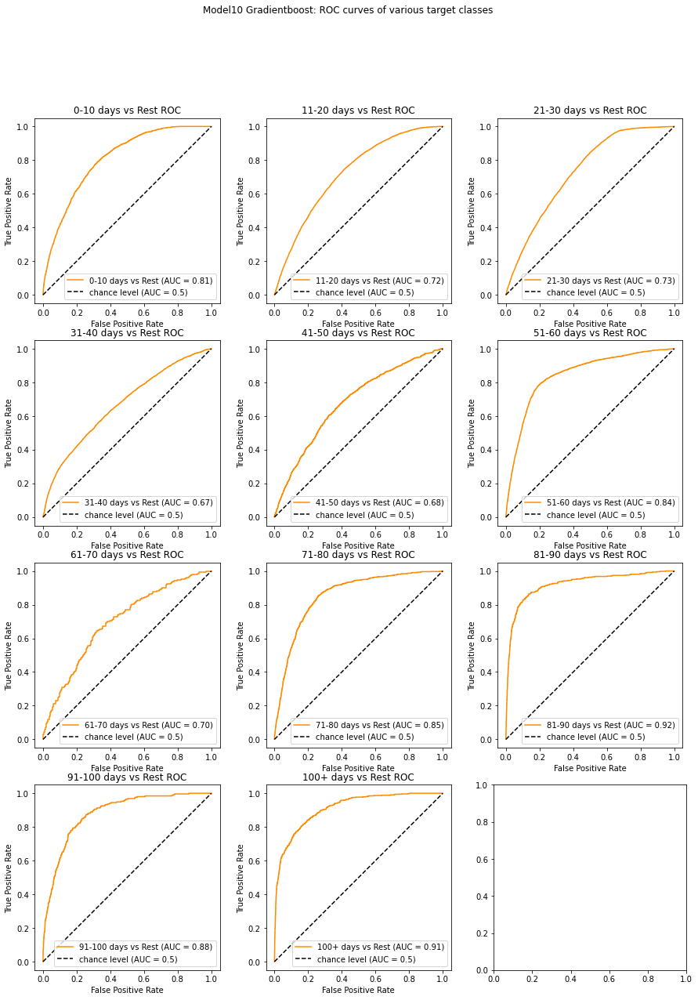

In [314]:
display_roc_curves(model10_grid.best_estimator_, X_test, y_test, "Model10 Gradientboost")

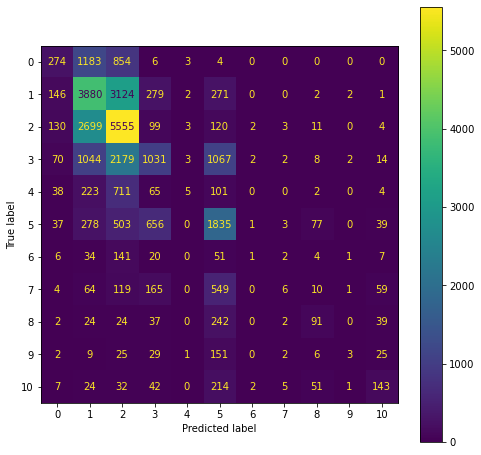

In [315]:
fig, axes = plt.subplots( figsize=(8, 8))
ConfusionMatrixDisplay.from_predictions(y_test, model10_grid.best_estimator_.predict(X_test), ax=axes)

In [316]:
model10_dims = len(model10_grid.best_estimator_.named_steps['selector'].get_feature_names_out().tolist())

In [317]:
results.append(['Model10', 'Gradientboost to compensate for high bias', '{}'.format(model10_grid.best_params_),
                '{}'.format(model10_dims),
                '{}/{}/{}'.format(model10_acc_train, model10_acc_dev, model10_acc_test),
                model10_f1_test])

##### <ins>Conclusion on Model 10:</ins>
Little bit of improvement compared to Adaboost and that's about it!!

#### Model 11: RandomForest ensemble model
The goal is to try to leverage the 99.6% accuracy seen on training data in Model6 with the very deep decision tree model coupled with a bagging technique. Bagging is built on the construct of a base classifier having high variance, which is true in Model6 case (as training score is very high, but dev/test scores aren't)


In [318]:
n_trees = [1, 10, 50]

In [319]:
oob_scores = []
forests = []
for i in range(len(n_trees)):
    cur_forest = Pipeline(steps=[('transformer', ohe_transformer),
                         ('selector', SelectFromModel(Lasso(alpha=0.01, fit_intercept=True))),
                         ('rf', \
                            RandomForestClassifier(n_estimators=n_trees[i], max_depth=100, random_state=42, oob_score=True))])
    cur_forest.fit(X_train, y_train)
    forests.append(cur_forest)
    oob_scores.append(cur_forest.named_steps['rf'].oob_score_)

print(oob_scores)

[0.153042871824989, 0.30914605050653354, 0.33507377771252383]


In [320]:
for i in range(len(n_trees)):
    model11_acc_train = round(accuracy_score(y_train, forests[i].predict(X_train))*100, 2)
    model11_acc_dev   = round(accuracy_score(y_dev, forests[i].predict(X_dev))*100, 2)
    model11_acc_test  = round(accuracy_score(y_test, forests[i].predict(X_test))*100, 2)
    model11_f1_test = round(f1_score(y_test, forests[i].predict(X_test), average='micro')*100, 2)

    print(f'Model11 accuracy with {n_trees[i]} estimators on train-data:\t{model11_acc_train}')
    print(f'Model11 accuracy with {n_trees[i]} estimators on dev-data:\t{model11_acc_dev}')
    print(f'Model11 accuracy with {n_trees[i]} estimators accuracy on test-data:\t{model11_acc_test}')
    print(f'Model11 accuracy with {n_trees[i]} estimators F1 score on test-data:\t{model11_f1_test}')
    print('\n')

Model11 accuracy with 1 estimators on train-data:	73.72
Model11 accuracy with 1 estimators on dev-data:	28.93
Model11 accuracy with 1 estimators accuracy on test-data:	28.51
Model11 accuracy with 1 estimators F1 score on test-data:	28.51


Model11 accuracy with 10 estimators on train-data:	96.69
Model11 accuracy with 10 estimators on dev-data:	33.27
Model11 accuracy with 10 estimators accuracy on test-data:	33.02
Model11 accuracy with 10 estimators F1 score on test-data:	33.02


Model11 accuracy with 50 estimators on train-data:	99.81
Model11 accuracy with 50 estimators on dev-data:	33.98
Model11 accuracy with 50 estimators accuracy on test-data:	33.79
Model11 accuracy with 50 estimators F1 score on test-data:	33.79




In [321]:
results.append(['Model11', 'RandomForests with deep trees to compensate for high variance',
                'max_depth: {}'.format(forests[2].named_steps['rf'].get_params()['max_depth']),
                '{}'.format(30),
                '{}/{}/{}'.format(model11_acc_train, model11_acc_dev, model11_acc_test),
                model11_f1_test])

##### <ins>Conclusion on Model 11:</ins>
How many be the number of deep trees in the randomforest, the models are doing well on training data (high variance) but falling flat on unseen (dev/test) data.

In [322]:
results_df = pd.DataFrame(data=results, 
                          columns=['Model-name', 'Description', 'Purpose/Hyper-parameters', '# Dimensions', 'Train/Dev/Test Accuracies', 'F1 Score'])

In [323]:
results_df

,Model-name,Description,Purpose/Hyper-parameters,# Dimensions,Train/Dev/Test Accuracies,F1 Score
0,Model0,Random guessing,For a baseline,---,9.09,---
1,Model1,Logistic Regr,Initial logistic regr model,---,38.91/38.85/38.65,38.65
2,Model2,Logistic Regr with OneHot on all categ,Consolidated onehot encoding,130,38.97/38.89/38.87,38.87
3,Model3,GridSearch Logistic Regr hyper params,"{'lgr__C': 0.18957356524063793, 'lgr__max_iter...",130,40.13/40.14/40.13,40.13
4,Model4,GridSearch kNN hyper params,{'knn__n_neighbors': 85},130,40.83/39.21/39.25,39.25
5,Model5,Decision Tree 1,Moderate depth of 10,130,42.14/41.22/41.22,41.22
6,Model6,Decision Tree 2,Deeper tree (max-depth=100),130,99.96/30.07/30.04,30.04
7,Model7,Gridsearch on Decision tree,"{'dt__max_depth': 10, 'dt__min_impurity_decrea...",130,39.58/40.04/39.98,39.98
8,Model8,Gridsearch on Feature extraction alpha,{'selector__estimator__alpha': 0.01},30,41.7/40.65/40.42,40.42
9,Model9,Adaboost to compensate for high bias,{'boost__n_estimators': 25},30,36.96/37.32/37.38,37.38


### Recommendation:

Model 5 and Model 10 in the above table, have the highest predictive capability of all the models. 


If I were to recommend using a model, I would recommend Model 10, because of the fact that it is an ensemble technique and a better diverse model compared to a single decision tree.

#### Using permutation feature importance:
Let's look at the which feature(s) had the most influence on predicting the target in our recommended model (Model 10)

In [324]:
display_permutation_importance_features(model10_grid.best_estimator_, X_train, y_train, X_test, y_test, descr="Model10")

Permutation importance on train dataset on Model10
Visitors 0.136 +/- 0.001
Ward_type 0.063 +/- 0.000
Bed_grade 0.023 +/- 0.000
Admission_deposit 0.018 +/- 0.001
Severity_illness 0.012 +/- 0.000
Admission_type 0.011 +/- 0.000
City_code_patient 0.006 +/- 0.000
Avail_extra_rooms 0.005 +/- 0.000
Age      0.004 +/- 0.000
Ward_facility_code 0.004 +/- 0.000
Department 0.003 +/- 0.000
Hospital_code 0.003 +/- 0.000
City_code_hospital 0.002 +/- 0.000
Hospital_type_code 0.001 +/- 0.000
Hospital_region_code 0.000 +/- 0.000

Permutation importance on test dataset on Model10
Visitors 0.135 +/- 0.002
Ward_type 0.064 +/- 0.001
Bed_grade 0.024 +/- 0.001
Admission_deposit 0.014 +/- 0.001
Severity_illness 0.013 +/- 0.001
Admission_type 0.010 +/- 0.001
City_code_patient 0.008 +/- 0.001
Ward_facility_code 0.006 +/- 0.001
Avail_extra_rooms 0.005 +/- 0.001
City_code_hospital 0.004 +/- 0.001
Hospital_code 0.003 +/- 0.001
Age      0.003 +/- 0.001
Department 0.001 +/- 0.001
Hospital_type_code 0.001 +/- 0.001
H

### Conclusion:



I have built several models, as shown in the table above, in the goal of improving the prediction performance while keeping the model complexity in check.
Overall, the models have performed much better in comparison with someone doing random guessing of predicting the Stay of a patient. 
However, most models had tough time raising the prediction accuracy beyond 45%. 
    
This is a challenging dataset: There are 11 classes in the target variable. In general with datasets like this, the odds of predicting the correct class slims down in comparison with datasets with fewer classes in the target variable. Also, the distribution of classes in target variable is very uneven.


Only, the very deep Decision trees have exhibited very high training accuracy. The rest of the models had 40-45% accuracy even with the training data, pointing that there was high bias. Even the deep decision trees had accuracy on the lower side with the dev and test data, again pointing that there was high bias.


The AUC in the ROC curves of some target classes were good while the other target classes weren't performing well. This is reflected in the overall F1 score.


The ensemble techniques did not improve the performance either. One potential reason for this could be because of (2) listed in the Data Understanding stage. The inherent requirement of Ensemble techiniques, which is: the crowd should have independent opinions. In this dataset, there are many Case_ids per Patient_id; this might be intuitively violating the above inherent requirement, as there are multiple records for a single patient (that is, the crowd is not independent).


The top 5 features that has most impact on predicting the target variable in our recommended model (Model 10) are: (i) Visitors (ii)Ward_type (iii)Bed_grade (iv) Admission_deposit (v) Severity_illness

One interesting observation from the Confusion matrix of Model 10 (and also other models) is that, The False-Positives and False-Negatives of a given target class lie mostly in the adjacent class; for ex: for True class = 2 (a.k.a. 21-30 days of Stay), Model 10 correctly predicted 5555 cases as Predicted class = 2. There are 2699 cases that Model is predicting as class = 1 whose True class = 2 (ie, False Negatives). This is observed in many target classes. This is useful intuition because, if the target classes were reduced from 11 to say 3 or say 4, the prediction performance would be lot higher. 
In other words, for a non-technical person, if the tool is predicting as class = X, be a little more generic and do the resource management for classes X-1, X and X+1 for that case. The odds of succeeded will improve with this scheme. Given the limited features in the data, this is probably a decent compromise for the user of the model.


### Summary of the project to non-technical audience:


The goal of the project is to provide a 'tool' to the Hospital management in estimating the length of Stay of a patient, given certain characteristics of the patient.

The tool takes these characteristics of the patient as input from the Hospital management, then does a statistical analysis based of historical information and provides the management with an estimated length of Stay. This helps the Hospital management to align the necessary resources for that amount of time for the given patient.

With the limited amount of historical data provided to the tool, this project work has found that the tool can estimate the length of Stay with a 42% correctness. This measure of correctness is found by testing the tool with a subset of samples from the historical data.

An interesting fact also observed from the testing of the tool is: of the cases that the tool estimated incorrectly, the correct estimation is a close neighbor. For example, for some of the test samples, the tool estimated a Stay of 21-30 days, while the correct Stay for most of those samples were either  11-20 days or 31-40 days.

Given that there are only limited number of characteristics of the patients, my recommendation to the Hospital management is to use this tool as a complimentary asset for resource estimation and be prepared to allocate resources for a slightly wider range of Stay to be more successful.

### Next steps and Recommendations:

From a technical standpoint, a few next steps I identified in this entire exercise:
1. Understand how to gather insights from permutation importance of a categorical variable (for ex: perm importance of 'Ward_type' is 0.063: What does this mean? which Ward_type is influencing the target variable?)


2. Use Explainable AI (XAI) techniques to understand why a model is behaving the way it is. Some of the XAI techniques I would like to explore is SHAP and LIME. This is part of my future work


3. Based on outcomes from (2), fine-tune the model(s) to reduce the false positives and false negatives